# Video Detection

In [ ]:
!pip install ultralytics

In [ ]:
!pip install opencv-python

In [ ]:
from ultralytics import YOLO
import cv2
import math

# model
model = YOLO("yolo-Weights/yolov8n.pt")

# object classes
classNames = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck", "boat",
              "traffic light", "fire hydrant", "stop sign", "parking meter", "bench", "bird", "cat",
              "dog", "horse", "sheep", "cow", "elephant", "bear", "zebra", "giraffe", "backpack", "umbrella",
              "handbag", "tie", "suitcase", "frisbee", "skis", "snowboard", "sports ball", "kite", "baseball bat",
              "baseball glove", "skateboard", "surfboard", "tennis racket", "bottle", "wine glass", "cup",
              "fork", "knife", "spoon", "bowl", "banana", "apple", "sandwich", "orange", "broccoli",
              "carrot", "hot dog", "pizza", "donut", "cake", "chair", "sofa", "pottedplant", "bed",
              "diningtable", "toilet", "tvmonitor", "laptop", "mouse", "remote", "keyboard", "cell phone",
              "microwave", "oven", "toaster", "sink", "refrigerator", "book", "clock", "vase", "scissors",
              "teddy bear", "hair drier", "toothbrush"
              ]

# Путь к видеофайлу
video_path = 'video_1.mp4'  # Обновите этот путь в соответствии с вашим видеофайлом
cap = cv2.VideoCapture(video_path)

# Получение параметров видео для записи результата (если нужно)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS)) # количество кадров в секунду
fourcc = cv2.VideoWriter_fourcc(*'mp4v') # 4-байтовый код, который используется для указания видеокодека
frame_number = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # количество кадров в видео
print('Number of frames in video:', frame_number)
# Сохранение видеофайла
out = cv2.VideoWriter('output_1_YOLO.mp4', fourcc, fps, (width, height))


while True:
    success, img = cap.read()
    results = model(img, stream=True)

    # coordinates
    for r in results:
        boxes = r.boxes

        for box in boxes:
            # bounding box
            x1, y1, x2, y2 = box.xyxy[0]
            x1, y1, x2, y2 = int(x1), int(y1), int(x2), int(y2) # convert to int values

            # put box in cam
            cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 255), 3)

            # confidence
            confidence = math.ceil((box.conf[0]*100))/100
            print("Confidence --->", confidence)

            # class name
            cls = int(box.cls[0])
            print("Class name -->", classNames[cls])

            # object details
            org = [x1, y1]
            font = cv2.FONT_HERSHEY_SIMPLEX
            fontScale = 1
            color = (255, 0, 0)
            thickness = 2

            cv2.putText(img, classNames[cls], org, font, fontScale, color, thickness)

    out.write(img)

cap.release()
out.release()
cv2.destroyAllWindows()

In [ ]:
print('Number of frames in video 1:', frame_number)

Number of frames in video 1: 200


In [ ]:
print('Number of frames in video 2:', frame_number)

Number of frames in video 2: 349


# Image Detection

In [ ]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
from PIL import Image
import os

In [ ]:
model = YOLO("yolov8m.pt")

100%|██████████| 49.7M/49.7M [00:00<00:00, 158MB/s]


In [ ]:
path = 'images/'
images = os.listdir(path)


for img in range(len(images)):
  image = f'{path}{images[img]}'
  results = model.predict(image)
  result = results[0]

  img_detective = Image.fromarray(result.plot()[:,:,::-1])
  # Сохранение изображения
  img_detective.save(f'detective_images/image_{img+1}.jpg')

  # Доп информация об объектах на изображениях
  for box in result.boxes:
    class_id = result.names[box.cls[0].item()]
    cords = box.xyxy[0].tolist()
    cords = [round(x) for x in cords]
    conf = round(box.conf[0].item(), 2)
    print("---")
    print("Object type:", class_id)
    print("Coordinates:", cords)
    print("Probability:", conf)
    print("Speed:", result.speed)
  print("--------------------------------------------")


image 1/1 /content/images/image8.jpg: 384x640 9 persons, 1 train, 1 zebra, 2 giraffes, 4561.5ms
Speed: 22.7ms preprocess, 4561.5ms inference, 37.6ms postprocess per image at shape (1, 3, 384, 640)
---
Object type: giraffe
Coordinates: [198, 142, 475, 535]
Probability: 0.95
Speed: {'preprocess': 22.669076919555664, 'inference': 4561.542272567749, 'postprocess': 37.607669830322266}
---
Object type: zebra
Coordinates: [459, 414, 749, 587]
Probability: 0.9
Speed: {'preprocess': 22.669076919555664, 'inference': 4561.542272567749, 'postprocess': 37.607669830322266}
---
Object type: giraffe
Coordinates: [403, 156, 821, 616]
Probability: 0.83
Speed: {'preprocess': 22.669076919555664, 'inference': 4561.542272567749, 'postprocess': 37.607669830322266}
---
Object type: person
Coordinates: [740, 302, 772, 346]
Probability: 0.67
Speed: {'preprocess': 22.669076919555664, 'inference': 4561.542272567749, 'postprocess': 37.607669830322266}
---
Object type: person
Coordinates: [888, 303, 933, 351]
Prob

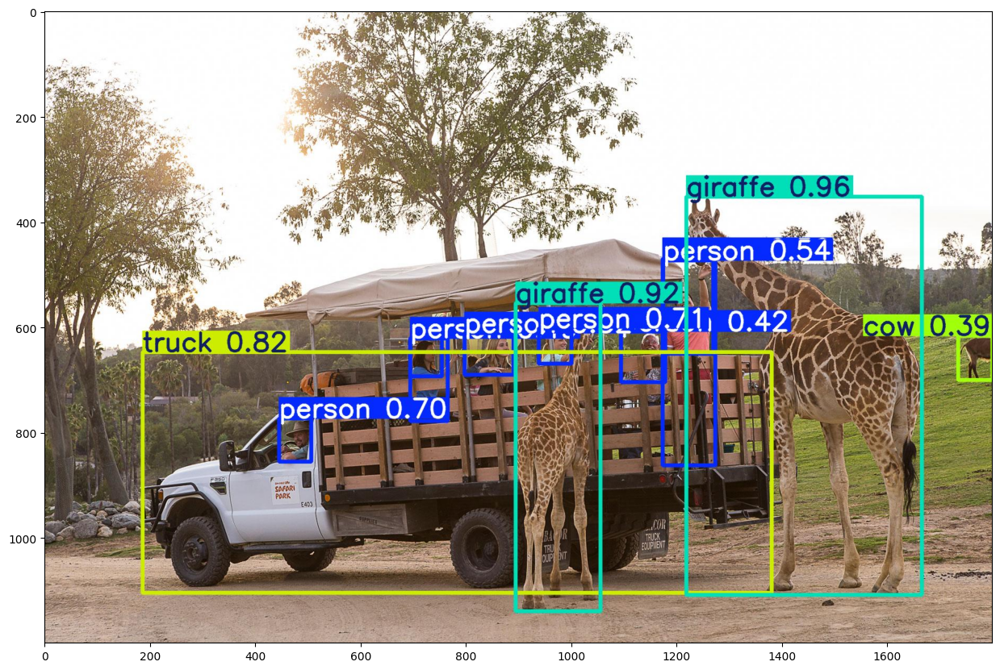

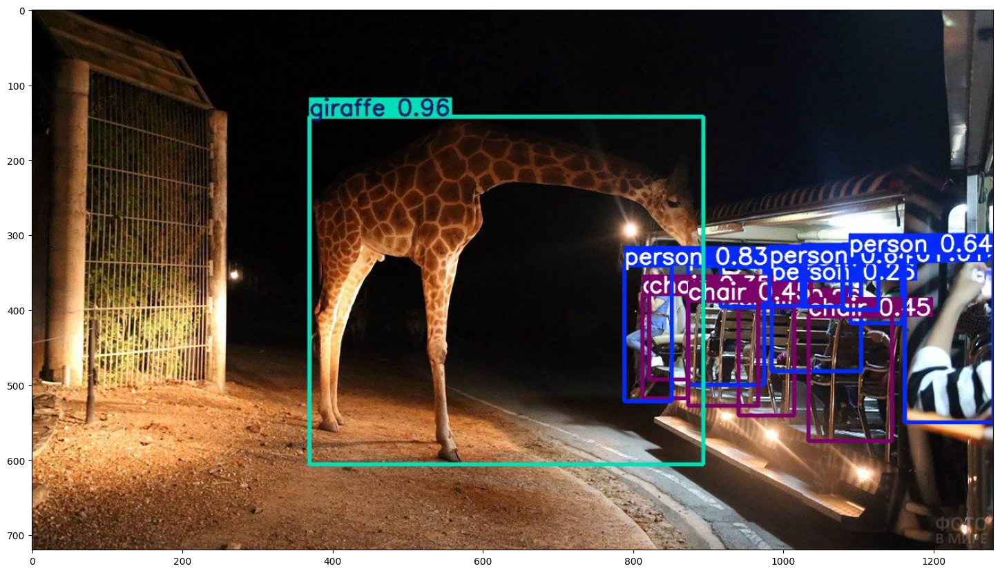

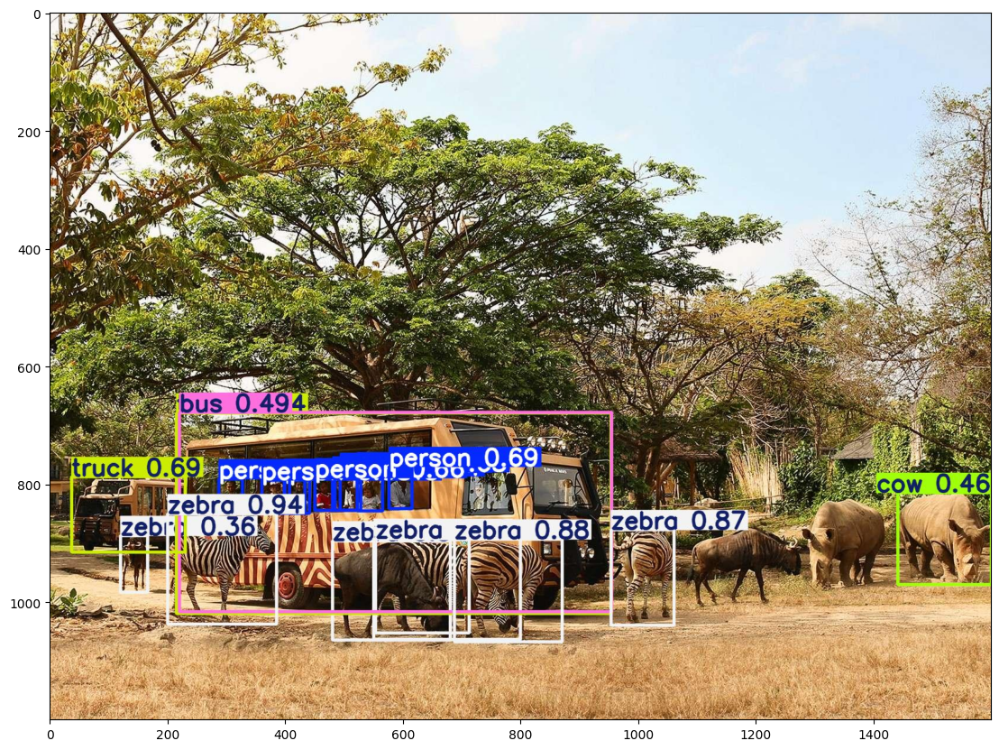

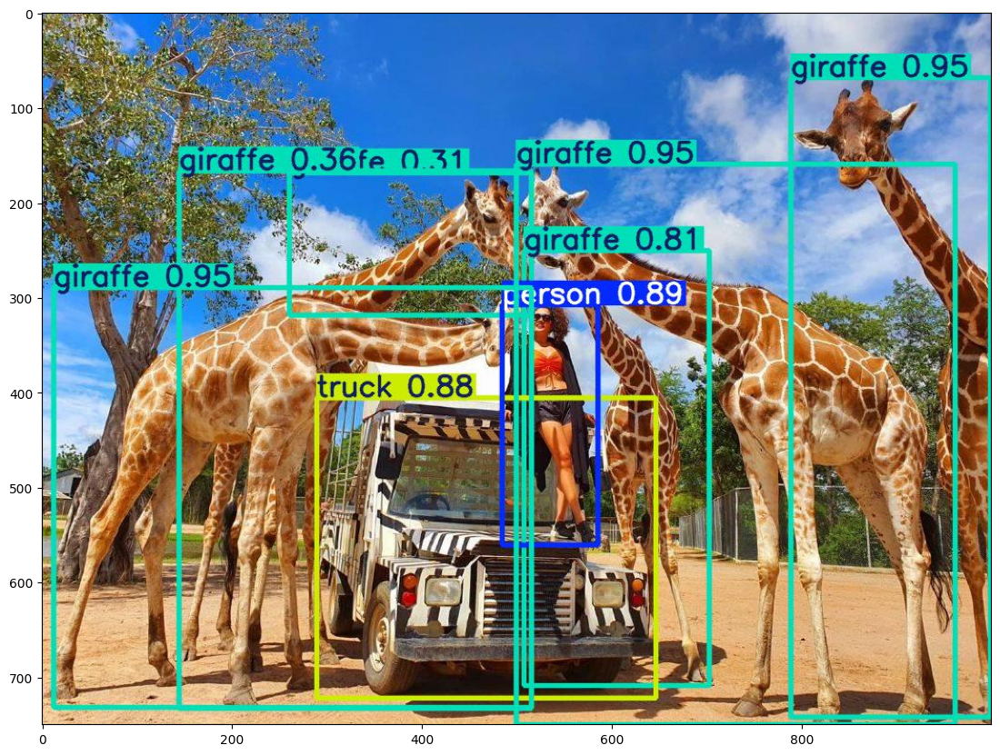

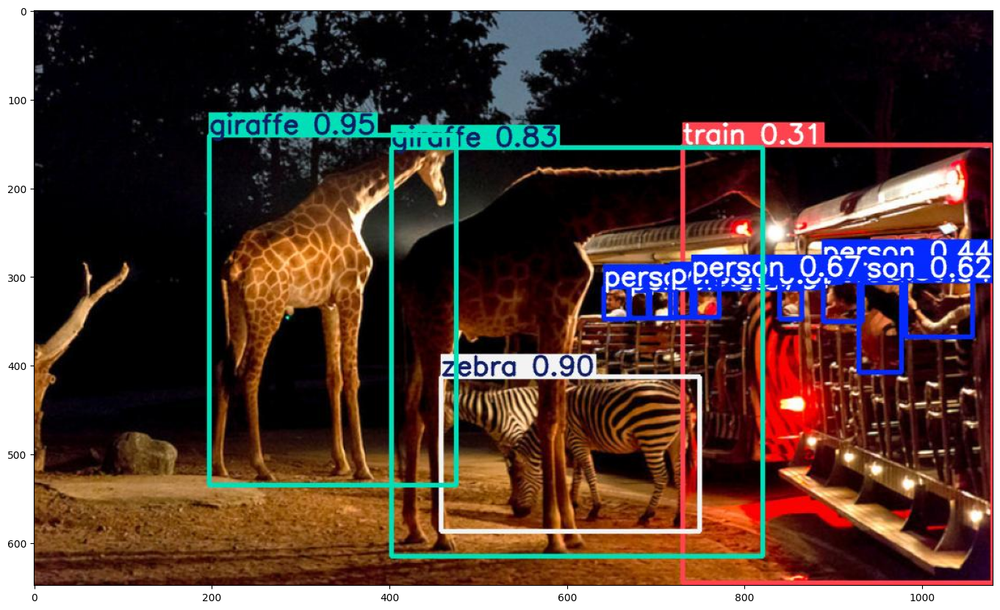

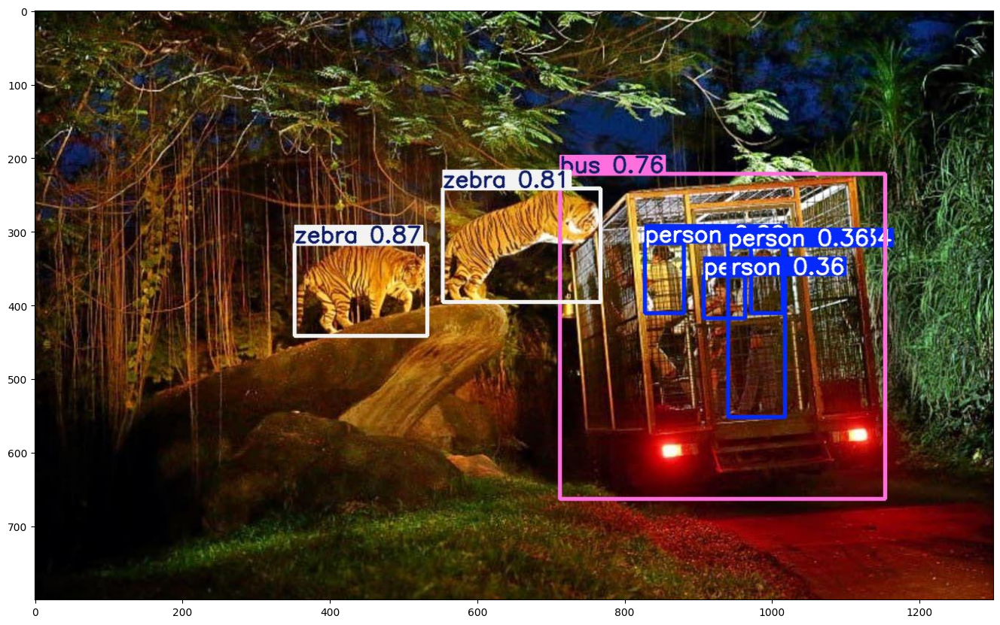

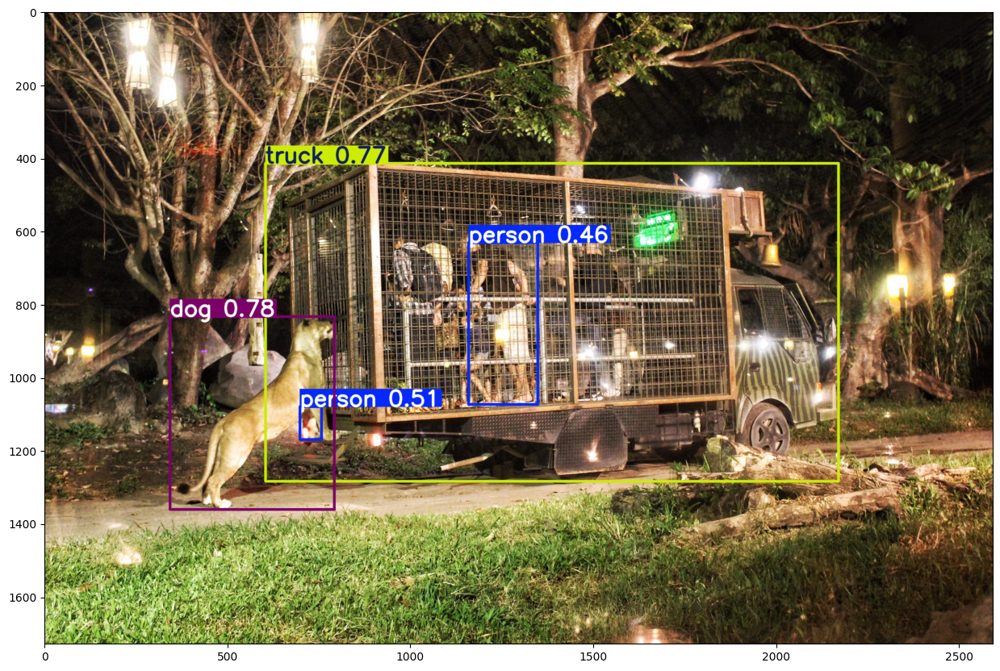

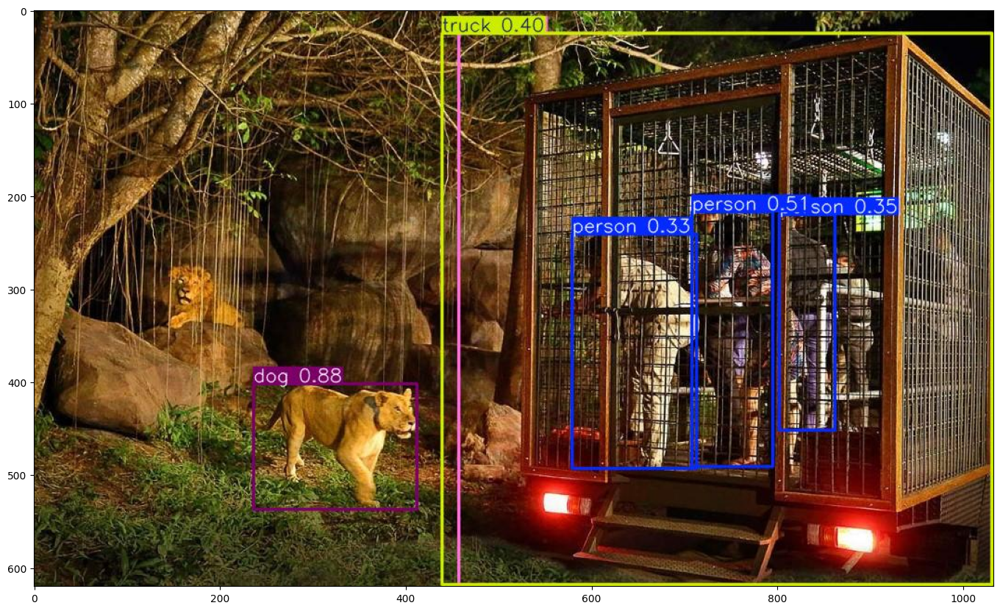

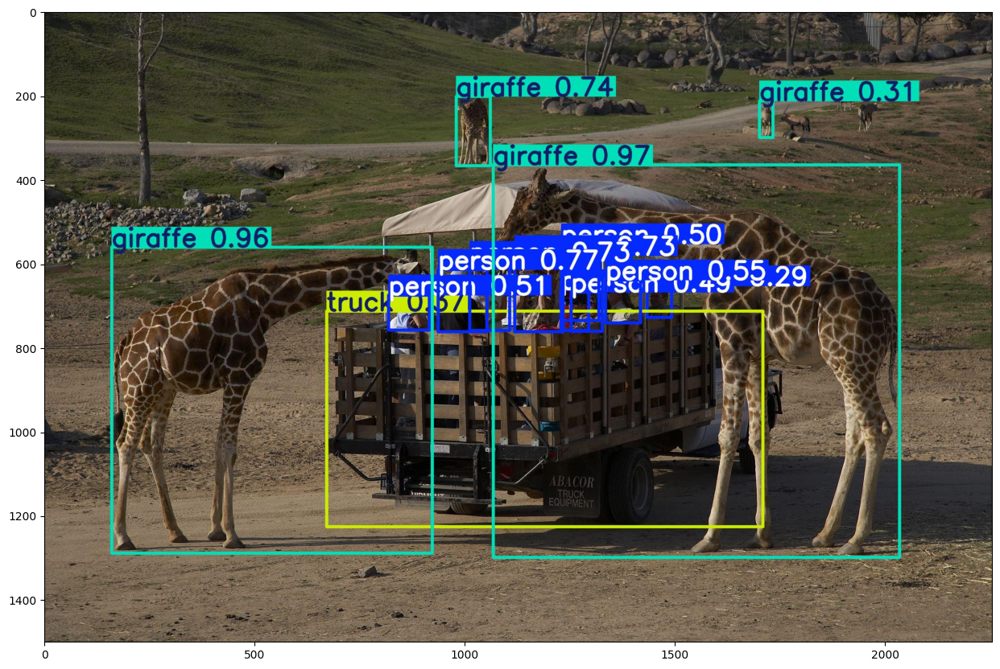

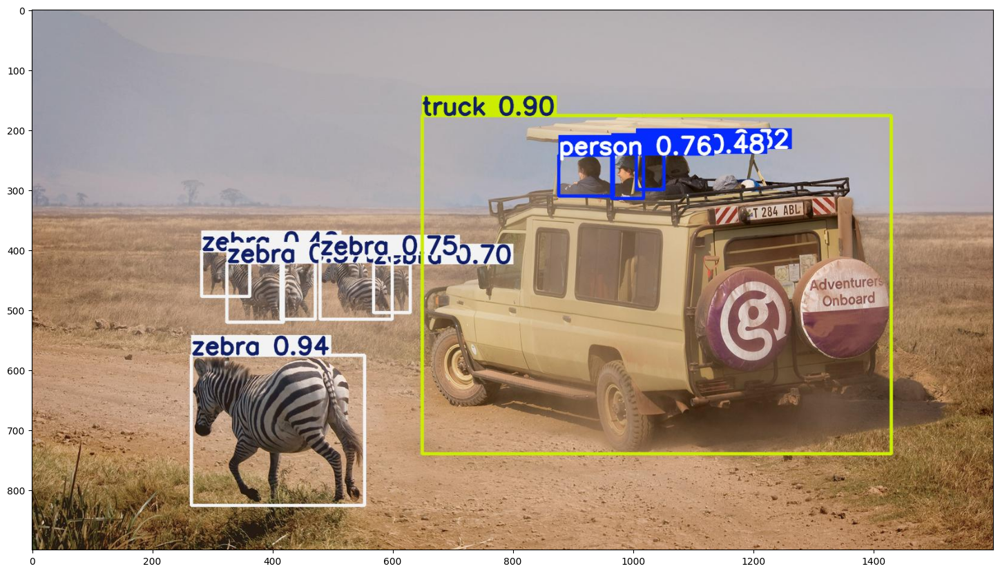

In [ ]:
path = 'detective_images/'
files = os.listdir(path)

for idx, img in enumerate(files):
  image = Image.open(f'{path}{img}')
  plt.figure(figsize=(60,120))
  plt.subplot(len(files), 1, 1)
  plt.imshow(image)
plt.show()